# **Lets Try to build Brain Tumour Detection CNN Model**

In [ ]:
#!unzip "/content/drive/MyDrive/Brain Tumour Project /archive.zip" -d "/content/drive/MyDrive/Brain Tumour Project "

In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import tensorflow_hub as hub

In [ ]:
print("TF Version:",tf.__version__)
print("TF Hub Version:", hub.__version__)

TF Version: 2.17.1
TF Hub Version: 0.16.1


In [ ]:
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not avaliable")

GPU available


## Lets Import data And Change This to Data Frame

In [ ]:
import os
import pandas as pd

# Path to your Training directory
base_path = '/content/drive/MyDrive/Brain Tumour Project /Training'

# Initialize an empty list to hold the data
data = []

# Walk through each folder and file
for folder_name in os.listdir(base_path):
    folder_path = os.path.join(base_path, folder_name)
    if os.path.isdir(folder_path):  # Ensure it's a folder
        for file_name in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file_name)
            if os.path.isfile(file_path):  # Ensure it's a file
                data.append({'File_Path': file_path, 'Brain_tumour_type': folder_name})

# Convert the list to a DataFrame
df = pd.DataFrame(data)

# Display the DataFrame
print(df)

# save the DataFrame to a CSV file
df.to_csv('brain_tumor_dataset.csv', index=False)


                                              File_Path Brain_tumour_type
0     /content/drive/MyDrive/Brain Tumour Project /T...      glioma_tumor
1     /content/drive/MyDrive/Brain Tumour Project /T...      glioma_tumor
2     /content/drive/MyDrive/Brain Tumour Project /T...      glioma_tumor
3     /content/drive/MyDrive/Brain Tumour Project /T...      glioma_tumor
4     /content/drive/MyDrive/Brain Tumour Project /T...      glioma_tumor
...                                                 ...               ...
2865  /content/drive/MyDrive/Brain Tumour Project /T...   pituitary_tumor
2866  /content/drive/MyDrive/Brain Tumour Project /T...   pituitary_tumor
2867  /content/drive/MyDrive/Brain Tumour Project /T...   pituitary_tumor
2868  /content/drive/MyDrive/Brain Tumour Project /T...   pituitary_tumor
2869  /content/drive/MyDrive/Brain Tumour Project /T...   pituitary_tumor

[2870 rows x 2 columns]


In [ ]:
df.head()

,File_Path,Brain_tumour_type
0,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
1,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
2,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
3,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
4,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor


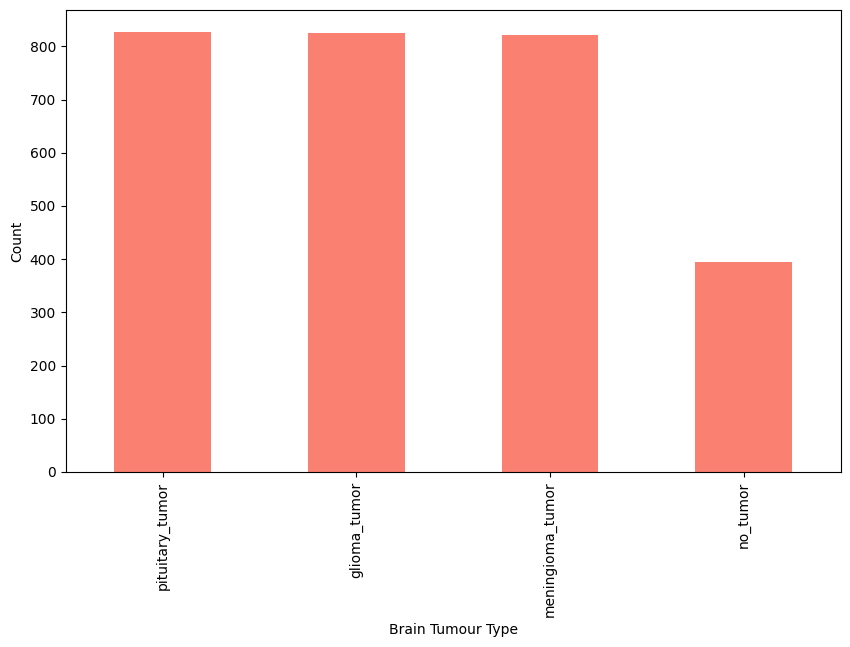

In [ ]:
df['Brain_tumour_type'].value_counts().plot(kind="bar",
                                            color="salmon",
                                            xlabel="Brain Tumour Type",
                                            ylabel="Count",
                                            figsize=(10,6))
plt.show()

In [ ]:
df['Brain_tumour_type'].value_counts().mean()

717.5

In [ ]:
file_names=[fname for fname in df["File_Path"]]
file_names

['/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (212).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (251).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (184).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (637).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (436).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (484).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (624).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (461).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (320).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (449).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (391).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (588

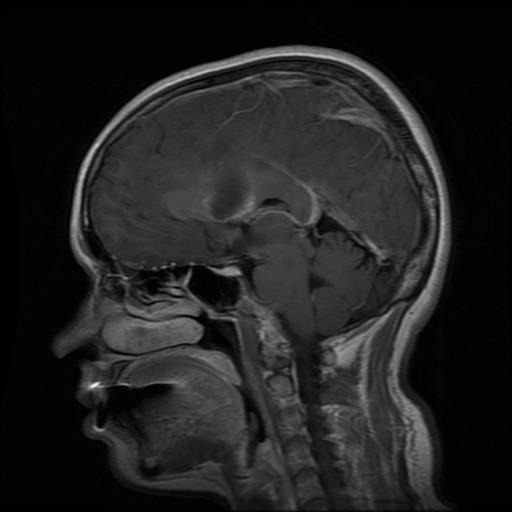

In [ ]:
from IPython.display import Image
Image(file_names[0])

In [ ]:
df['Brain_tumour_type'][0]

'glioma_tumor'

In [ ]:
import os

# Define the paths for the directories
base_path = "/content/drive/MyDrive/Brain Tumour Project /Training"
categories = ["glioma_tumor", "meningioma_tumor", "no_tumor", "pituitary_tumor"]

# Count the total number of files in all subdirectories
total_files = sum(len(os.listdir(os.path.join(base_path, category))) for category in categories)

# Assume file_names is a predefined list of expected file names
# Example: file_names = ['file1.jpg', 'file2.jpg', ...]
if total_files == len(file_names):
    print("Yes, they match")
else:
    print(f"No, it doesn't match. Expected: {len(file_names)}, Found: {total_files}")


Yes, they match


## Lets Convert labels into Numbers

In [ ]:
labels = df["Brain_tumour_type"]
labels = np.array(labels)
labels

array(['glioma_tumor', 'glioma_tumor', 'glioma_tumor', ...,
       'pituitary_tumor', 'pituitary_tumor', 'pituitary_tumor'],
      dtype=object)

In [ ]:
if len(labels)==len(file_names):
  print("Yes they match!")
else:
  print("Not matching")

Yes they match!


In [ ]:

# unique items
unique_brain_tumour_types = np.unique(labels)
unique_brain_tumour_types

array(['glioma_tumor', 'meningioma_tumor', 'no_tumor', 'pituitary_tumor'],
      dtype=object)

In [ ]:
len(unique_brain_tumour_types)

4

In [ ]:
boolean_labels=[label == np.array(unique_brain_tumour_types) for label in labels]
boolean_labels[:2]

[array([ True, False, False, False]), array([ True, False, False, False])]

In [ ]:
len(boolean_labels)

2870

In [ ]:
len(file_names)

2870

In [ ]:
print(labels[0]) # original label
print(np.where(unique_brain_tumour_types==labels[0])) # index where label occurs
print(boolean_labels[0].argmax())
print(boolean_labels[0].astype(int))

glioma_tumor
(array([0]),)
0
[1 0 0 0]


## Creating Validation set

In [ ]:
file_names[:2]

['/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (212).jpg',
 '/content/drive/MyDrive/Brain Tumour Project /Training/glioma_tumor/gg (251).jpg']

In [ ]:
boolean_labels[:2]

[array([ True, False, False, False]), array([ True, False, False, False])]

In [ ]:
X=file_names
Y=boolean_labels

## We are going to experiment with 200 images make sure that our functions are working correctly

In [ ]:

NUM_IMAGES = 200 #@param {type:"slider", min:20, max:200, step:20}


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_val, Y_train, Y_val = train_test_split(X[:NUM_IMAGES],
                                                 Y[:NUM_IMAGES],
                                                 test_size=0.2,
                                                 random_state=42)
len(X_train),len(Y_train), len(X_val), len(Y_val)

(160, 160, 40, 40)

## Tuning Images into Tensor


In [ ]:
IMG_SIZE = 224 # image size
def process_image(image_path, img_size= IMG_SIZE):
  """
  Turn Image into Tensor
  """
  image=tf.io.read_file(image_path) # image binary array
  image=tf.image.decode_jpeg(image, channels=3) # turn jpeg into numerical tensor
  image=tf.image.convert_image_dtype(image, dtype=tf.float32) # convert color channels from 0-255 to 0-1
  image=tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE]) # image resize
  return image



# Turn Data Into badges

In [ ]:
def get_image_label(image_path,label):
  image=process_image(image_path)
  return image, label


In [ ]:
# Demo for above function
(process_image(X[42]),tf.constant(Y[42]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],
 
        [[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],
 
        [[0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         ...,
         [0.00392157, 0.00392157, 0.00392157],
         [0.00392157, 0.00392157, 0.00392157],
         [0.00392157, 0.00392157, 0.00392157]],
 
        ...,
 
        [[0.        , 0.        

In [ ]:
# Define the batch

BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(X, Y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (X) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X))) # only filepaths (no labels)
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), # filepaths
                                               tf.constant(Y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                               tf.constant(Y)))
    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(X))

    # Create (image, label) tuples (this also turns the iamge path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the training data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
# Create Train and validation batch

train_data=create_data_batches(X_train, Y_train) # calling above function
valid_data=create_data_batches(X_val, Y_val, valid_data=True)


Creating training data batches...
Creating validation data batches...


In [ ]:
train_data.element_spec, valid_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 4), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 4), dtype=tf.bool, name=None)))

## Visualizing the images

In [ ]:


import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_10_images(images, labels):
  """
  Displays a plot of 25 images and their labels from a data batch.
   Namma kitta oru batch la 32 images iruku but namma 25 images ah display panna porom
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(10):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_brain_tumour_types[labels[i].argmax()])
    # Turn the grid lines off
    plt.axis("off")

In [ ]:
train_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 4), dtype=tf.bool, name=None))>

In [ ]:
# # Now let's visualize the data in a training batch
train_images,train_labels = next(train_data.as_numpy_iterator())
train_images,train_labels

(array([[[[0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          ...,
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ]],
 
         [[0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          ...,
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ]],
 
         [[0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          ...,
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ],
          [0.        , 0.        , 0.        ]],
 
         ...,
 
         [[0.        , 0.        , 0.        ],
          [0.     

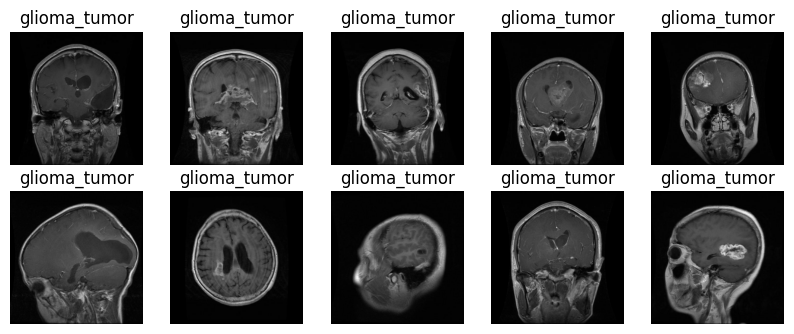

In [ ]:
# Now vizualize the data in a training batch

show_10_images(train_images,train_labels)

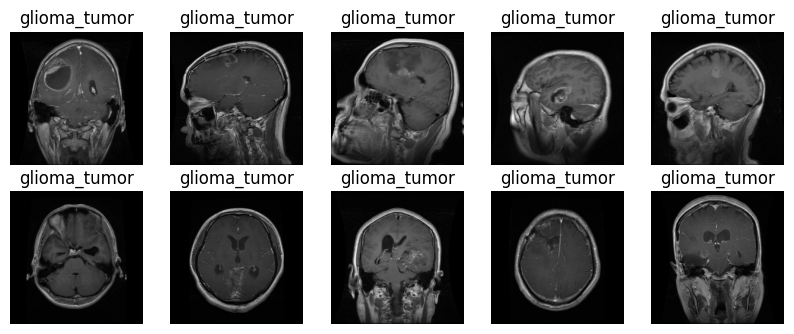

In [ ]:
valid_images, valid_labels = next(valid_data.as_numpy_iterator())
show_10_images(valid_images, valid_labels)

In [ ]:
# Lets train our model for 200 images

!pip install kagglehub --upgrade

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.9/51.9 kB 3.4 MB/s eta 0:00:00
  Attempting uninstall: kagglehub
    Found existing installation: kagglehub 0.3.5
    Uninstalling kagglehub-0.3.5:
      Successfully uninstalled kagglehub-0.3.5


In [ ]:
# Lets import model from kaggle hub
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of our model
OUTPUT_SHAPE = len(unique_brain_tumour_types)

import kagglehub

# Download latest version
MODEL_URL = kagglehub.model_download("google/resnet-v2/tensorFlow2/101-classification")

print("Path to model files:", MODEL_URL)



100%|██████████| 9.53k/9.53k [00:00<00:00, 17.9MB/s]


  0%|          | 0.00/171M [00:00<?, ?B/s]

  0%|          | 0.00/2.79M [00:00<?, ?B/s]
  1%|          | 1.00M/171M [00:00<00:57, 3.07MB/s]

100%|██████████| 2.79M/2.79M [00:00<00:00, 6.93MB/s]

  2%|▏         | 4.00M/171M [00:00<00:15, 11.1MB/s]
  6%|▌         | 10.0M/171M [00:00<00:06, 25.8MB/s]
  8%|▊         | 14.0M/171M [00:00<00:05, 30.3MB/s]
 11%|█         | 18.0M/171M [00:00<00:06, 25.7MB/s]
 15%|█▍        | 25.0M/171M [00:01<00:05, 28.4MB/s]
 17%|█▋        | 29.0M/171M [00:01<00:05, 28.7MB/s]
 21%|██        | 35.0M/171M [00:01<00:04, 33.6MB/s]
 23%|██▎       | 40.0M/171M [00:01<00:03, 37.5MB/s]
 26%|██▌       | 44.0M/171M [00:01<00:04, 32.0MB/s]
 28%|██▊       | 48.0M/171M [00:01<00:03, 33.8MB/s]
 30%|███       | 52.0M/171M [00:01<00:03, 34.0MB/s]
 34%|███▍      | 58.0M/171M [00:02<00:04, 27.2MB/s]
 38%|███▊      | 64.0M/171M [00:02<00:03, 33.7MB/s]
 40%|███▉      | 68.0M/171M [00:02<00:03, 33.3MB/s]
 43%|████▎     | 73.0M/171M [00:02<00:03, 33.2MB/s]
 47%|████▋     | 80.0M/1

Path to model files: /root/.cache/kagglehub/models/google/resnet-v2/tensorFlow2/101-classification/2


In [ ]:
import tensorflow_hub as hub
layer = hub.KerasLayer(MODEL_URL, trainable=False)
layer
# model is ready to go

In [ ]:
!pip install tf_keras

In [ ]:
import tf_keras as keras

In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=keras.losses.CategoricalCrossentropy(),
      optimizer=keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE)

  return model

In [ ]:
model = create_model()
model.summary()


Building model with: /root/.cache/kagglehub/models/google/resnet-v2/tensorFlow2/101-classification/2
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1001)              44677609  
                                                                 
 dense (Dense)               (None, 4)                 4008      
                                                                 
Total params: 44681617 (170.45 MB)
Trainable params: 4008 (15.66 KB)
Non-trainable params: 44677609 (170.43 MB)
_________________________________________________________________


In [ ]:
# Load TensorBoard notebook extension
%load_ext tensorboard

# this is the magic function

In [ ]:
import datetime
import os


# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("/content/drive/MyDrive/logs",

  # Make it so the logs get tracked whenever we run an experiment (%year%month%day-%hour%minites% seconds)
  datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return keras.callbacks.TensorBoard(logdir)

In [ ]:
# Create early stopping callback
early_stopping = keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3)

## Training a model

In [ ]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [ ]:
## check the availability of GPU it is more important in machine learning task

print("GPU", "Available" if tf.config.list_physical_devices("GPU") else "Not Available")

GPU Available


In [ ]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  model = create_model()
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=valid_data,
            validation_freq=1,
            callbacks=[tensorboard, early_stopping])
  # Return the fitted model
  return model

In [ ]:
# Fit the model to the data
#model = train_model()
# iam already runned this and saved the model data to log folder so iam putting #

## Yes our model working fine on 200 images our functions also working well

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/logs

<IPython.core.display.Javascript object>

In [ ]:
valid_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 4), dtype=tf.bool, name=None))>

In [ ]:
# Lets make a predictions
predictions = model.predict(valid_data, verbose=1)
predictions

2/2 [==============================] - 12s 1s/step


array([[9.55704600e-03, 1.86151356e-01, 6.59040391e-01, 1.45251244e-01],
       [8.62152781e-03, 7.00722495e-03, 8.94978344e-01, 8.93928781e-02],
       [5.31868869e-03, 5.33689104e-04, 9.41119432e-01, 5.30281365e-02],
       [1.15774125e-02, 3.14396210e-02, 9.40674841e-01, 1.63081642e-02],
       [6.33955896e-02, 2.43098721e-01, 4.63427663e-01, 2.30078056e-01],
       [3.19952741e-02, 2.10159849e-02, 7.36864209e-01, 2.10124508e-01],
       [6.57713797e-04, 1.88487679e-01, 6.74085319e-01, 1.36769280e-01],
       [1.11097470e-04, 2.07142541e-04, 9.81829762e-01, 1.78520698e-02],
       [5.28081320e-03, 7.42361665e-01, 1.45049915e-01, 1.07307620e-01],
       [2.93093122e-04, 6.62562698e-02, 8.95893455e-01, 3.75572331e-02],
       [1.01698702e-02, 4.04540241e-01, 4.82947022e-01, 1.02342822e-01],
       [6.71365783e-02, 2.58369483e-02, 6.10679626e-01, 2.96346873e-01],
       [7.76633387e-03, 3.68871813e-04, 9.70957518e-01, 2.09072661e-02],
       [1.48169161e-03, 7.14227848e-04, 9.96630967e

In [ ]:

predictions.shape

(40, 4)

In [ ]:
len(Y_val), len(unique_brain_tumour_types)

(40, 4)

In [ ]:
predictions[0]
# prediction proabiliity of specific images

array([0.00955705, 0.18615136, 0.6590404 , 0.14525124], dtype=float32)

In [ ]:
# First prediction
index = 1

print(predictions[index])
print(f"Max value (probability of prediction): {np.max(predictions[index])}")
print(f"Sum: {np.sum(predictions[index])}")
print(f"Max index: {np.argmax(predictions[index])}")
print(f"Predicted label: {unique_brain_tumour_types[np.argmax(predictions[index])]}")

[0.00862153 0.00700722 0.89497834 0.08939288]
Max value (probability of prediction): 0.8949783444404602
Sum: 1.0
Max index: 2
Predicted label: no_tumor


In [ ]:

def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_brain_tumour_types[np.argmax(prediction_probabilities)]
# above function demo
pred_label = get_pred_label(predictions[1])

pred_label



'no_tumor'

In [ ]:
## lets unbatch then only we are able to visualize
# Create a function to unbatch a batch dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and reutrns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_brain_tumour_types[np.argmax(label)])
  return images, labels

# above function demo
valid_images, valid_labels = unbatchify(valid_data)
valid_images[0], valid_labels[0]


(array([[[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        ...,
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]],
 
        [[0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.],
         ...,
         [0., 0., 0.],
         [0., 0., 0.],
         [0., 0., 0.]]], dtype=float32),
 'glioma_tumor')

In [ ]:
get_pred_label(predictions[0])
# our model predcited no_tumour but actually it is glioma_tumour

'no_tumor'

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth and image for sample n
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the colour of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  # Change plot title to be predicted, probability of prediction and truth label
  plt.title("{} {:2.0f}% {}".format(pred_label,
                                    np.max(pred_prob)*100,
                                    true_label),
                                    color=color)

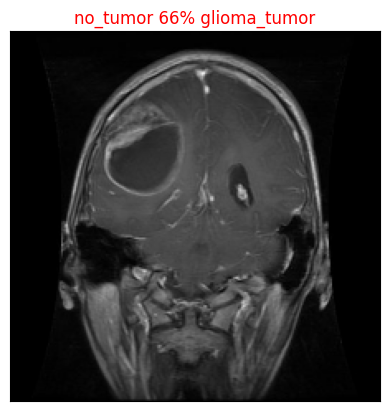

In [ ]:
# above function demo
plot_pred(prediction_probabilities=predictions,
          labels=valid_labels,
          images=valid_images,
          n=0)
# it predicts 66% no tumour but actually it is glioma tumour

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plus the top 10 highest prediction confidences along with the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_brain_tumour_types[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

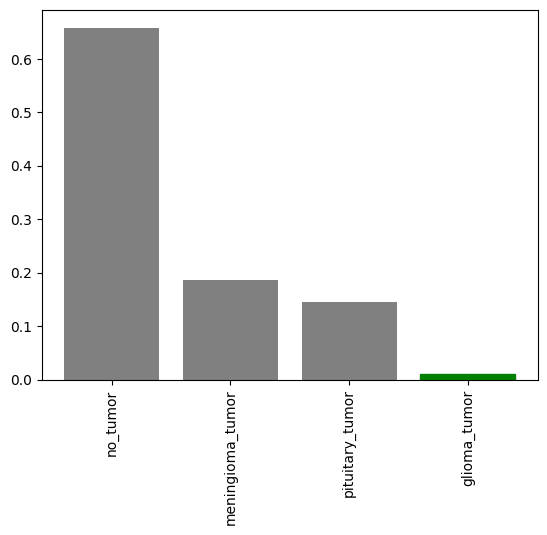

In [ ]:
# above function demo
plot_pred_conf(prediction_probabilities=predictions,
               labels=valid_labels,
               n=0)

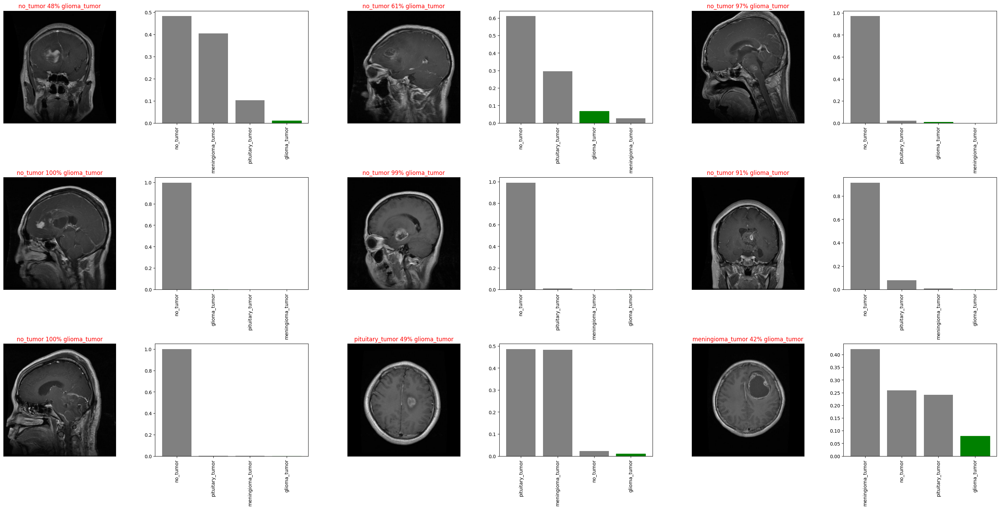

In [ ]:
# Let's check out a few predictions and their different values
i_multiplier = 10
num_rows = 3
num_cols = 3
num_images = num_rows*num_cols
plt.figure(figsize=(10*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=valid_labels,
            images=valid_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=valid_labels,
                 n=i+i_multiplier)  # plot_pred_conf namma create panna function munnadi iruku paaru atha call panniruku
plt.tight_layout(h_pad=1.0)
plt.show()

## Excellent all our functions are working fine before training with test data make sure that our functions are working fine this is important in deep learning model building because in real world scenario deep learning model takes so much time to train so if you made any mistake in functions and trained your model it will take long time to find and solve the errors so before entering to train and test data real data make sure that our functions working fine on small set of validation data this is important step in deep leanring

## Save and load model functions

In [ ]:
# Create a function to save a model
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (string).
  """
  # Create a model directory pathname with current time
  modeldir = os.path.join("/content/drive/MyDrive/Colab Notebooks/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [ ]:
# Create a function to load a trained model
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# lets try to make sure that this save and load model functions also working fine
# lets save demo model we trained above with 200 images

save_model(model, suffix="200-images-demo-model-resnet_v2")


Saving model to: /content/drive/MyDrive/Colab Notebooks/models/20250103-17081735924120-200-images-demo-model-resnet_v2.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'/content/drive/MyDrive/Colab Notebooks/models/20250103-17081735924120-200-images-demo-model-resnet_v2.h5'

In [ ]:
# lets try to reload our model it is saved in models directory
# Load a trained model
loaded_200_image_model = load_model("/content/drive/MyDrive/Colab Notebooks/models/20250103-17081735924120-200-images-demo-model-resnet_v2.h5") # model file_path


Loading saved model from: /content/drive/MyDrive/Colab Notebooks/models/20250103-17081735924120-200-images-demo-model-resnet_v2.h5


## Above demo model just trained with 200 images to make sure that our functions are working fine now lets train full dataset and make predictions

## above we confirmed that our functions are working fine lets dive into test data perdictions


In [ ]:
len(X), len(Y)

# this is the real data set len


(2870, 2870)

In [ ]:
# Create a data batch with the full data set
# calling create_data_batches above function
full_data = create_data_batches(X, Y)

Creating training data batches...


In [ ]:
full_data

<_BatchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 4), dtype=tf.bool, name=None))>

In [ ]:
full_model = create_model() # create model function we created above

Building model with: /root/.cache/kagglehub/models/google/resnet-v2/tensorFlow2/101-classification/2


In [ ]:
# Create full model callbacks
# below create tensorboard also we are calling above function
full_model_tensorboard = create_tensorboard_callback()
full_model_early_stopping = keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [ ]:
# Fit the full model to the full data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, full_model_early_stopping])

Epoch 1/100
90/90 [==============================] - 326s 4s/step - loss: 0.9774 - accuracy: 0.6415
Epoch 2/100
90/90 [==============================] - 15s 169ms/step - loss: 0.5225 - accuracy: 0.7934
Epoch 3/100
90/90 [==============================] - 15s 167ms/step - loss: 0.4499 - accuracy: 0.8279
Epoch 4/100
90/90 [==============================] - 15s 164ms/step - loss: 0.3916 - accuracy: 0.8505
Epoch 5/100
90/90 [==============================] - 15s 163ms/step - loss: 0.3620 - accuracy: 0.8641
Epoch 6/100
90/90 [==============================] - 15s 162ms/step - loss: 0.3349 - accuracy: 0.8812
Epoch 7/100
90/90 [==============================] - 15s 168ms/step - loss: 0.3151 - accuracy: 0.8861
Epoch 8/100
90/90 [==============================] - 15s 166ms/step - loss: 0.2974 - accuracy: 0.8861
Epoch 9/100
90/90 [==============================] - 15s 170ms/step - loss: 0.2795 - accuracy: 0.9010
Epoch 10/100
90/90 [==============================] - 15s 166ms/step - loss: 0.2644 

In [ ]:
# lets visualize our full data model performance using tensorboard

%tensorboard --logdir  /content/drive/MyDrive/logs/20250103-171611

<IPython.core.display.Javascript object>

## Excellent

In [ ]:
# save our model
save_model(full_model, suffix="full-image-set-resnetv2")

Saving model to: /content/drive/MyDrive/Colab Notebooks/models/20250103-17331735925609-full-image-set-resnetv2.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'/content/drive/MyDrive/Colab Notebooks/models/20250103-17331735925609-full-image-set-resnetv2.h5'

In [ ]:
# now load our full data set trained model

loaded_full_model = load_model('/content/drive/MyDrive/Colab Notebooks/models/20250103-17331735925609-full-image-set-resnetv2.h5')

Loading saved model from: /content/drive/MyDrive/Colab Notebooks/models/20250103-17331735925609-full-image-set-resnetv2.h5


## Beautiful lets start prediction with test data set here we go

In [ ]:
# Path to your Testing directory
test_base_path = '/content/drive/MyDrive/Brain Tumour Project /Testing'

# Load test data paths and labels
test_data = []
for folder_name in os.listdir(test_base_path):
    folder_path = os.path.join(test_base_path, folder_name)
    if os.path.isdir(folder_path):  # Ensure it's a folder
        for file_name in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file_name)
            if os.path.isfile(file_path):  # Ensure it's a file
                test_data.append({'File_Path': file_path, 'Brain_tumour_type': folder_name})

# Convert the list to a DataFrame
test_df = pd.DataFrame(test_data)

# Extract test file paths and labels
X_test = [fname for fname in test_df["File_Path"]]
Y_test = [unique_brain_tumour_types.tolist().index(label) for label in test_df["Brain_tumour_type"]]





# Convert labels to one-hot encoding
Y_test_one_hot = tf.keras.utils.to_categorical(Y_test, num_classes=len(unique_brain_tumour_types))


In [ ]:
test_df

,File_Path,Brain_tumour_type
0,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
1,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
2,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
3,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
4,/content/drive/MyDrive/Brain Tumour Project /T...,glioma_tumor
...,...,...
389,/content/drive/MyDrive/Brain Tumour Project /T...,pituitary_tumor
390,/content/drive/MyDrive/Brain Tumour Project /T...,pituitary_tumor
391,/content/drive/MyDrive/Brain Tumour Project /T...,pituitary_tumor
392,/content/drive/MyDrive/Brain Tumour Project /T...,pituitary_tumor


In [ ]:
test_data_batch = create_data_batches(X_test, Y_test_one_hot, test_data=True)


Creating test data batches...


In [ ]:
# Make predictions on the test data
test_predictions = loaded_full_model.predict(test_data_batch, verbose=1)

# Convert prediction probabilities to labels
test_pred_labels = [unique_brain_tumour_types[np.argmax(pred)] for pred in test_predictions]


13/13 [==============================] - 3s 181ms/step


In [ ]:
def unbatchify01(data, include_labels=True):
    """
    Takes a batched dataset of (image, label) Tensors and returns separate arrays
    of images and labels. Handles cases where labels are not included.
    """
    images = []
    labels = []

    # Loop through unbatched data
    for item in data.unbatch().as_numpy_iterator():
        if include_labels:
            image, label = item
            images.append(image)
            labels.append(unique_brain_tumour_types[np.argmax(label)])
        else:
            image = item  # Only image is available
            images.append(image)

    return (images, labels) if include_labels else images



In [ ]:
test_images = unbatchify01(test_data_batch, include_labels=False)




In [ ]:
test_predictions


array([[8.9137241e-02, 5.6852228e-03, 8.6400300e-01, 4.1174456e-02],
       [1.2447346e-02, 1.5150116e-02, 9.3435800e-01, 3.8044553e-02],
       [5.0586946e-03, 3.3702138e-03, 9.6535003e-01, 2.6221057e-02],
       ...,
       [2.6553620e-03, 2.3115562e-04, 5.8888078e-01, 4.0823269e-01],
       [3.8134870e-03, 9.9005578e-05, 9.9180335e-01, 4.2840997e-03],
       [4.3340128e-02, 6.0728870e-02, 6.4426732e-01, 2.5166368e-01]],
      dtype=float32)

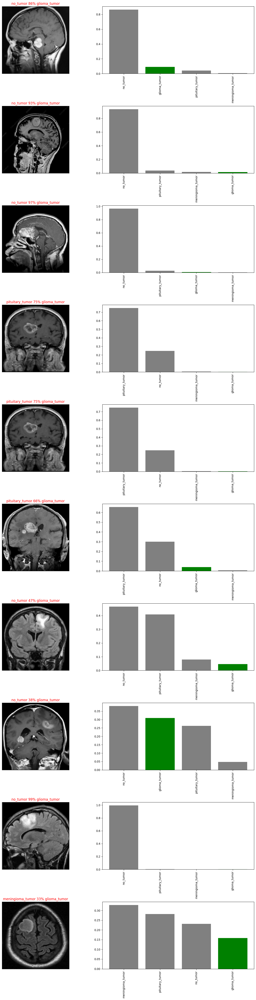

In [ ]:
# Step 1: Convert one-hot encoded labels to original labels (optional, if needed)
test_true_labels = [unique_brain_tumour_types[np.argmax(label)] for label in Y_test]

# Step 2: Visualize the predictions
num_images_to_display = 10  # Adjust for readability

plt.figure(figsize=(15, 5 * num_images_to_display))

for i in range(num_images_to_display):
    # Plot the image and its predicted label
    plt.subplot(num_images_to_display, 2, 2 * i + 1)
    plot_pred(prediction_probabilities=test_predictions,
              labels=test_true_labels,
              images=test_images,
              n=i)

    # Plot the prediction confidence
    plt.subplot(num_images_to_display, 2, 2 * i + 2)
    plot_pred_conf(prediction_probabilities=test_predictions,
                   labels=test_true_labels,
                   n=i)

plt.tight_layout()
plt.show()


In [ ]:
from sklearn.metrics import accuracy_score

# Calculate accuracy
accuracy = accuracy_score(test_true_labels, test_pred_labels)
print(f'Accuracy: {accuracy:.4f}')


Accuracy: 0.0939


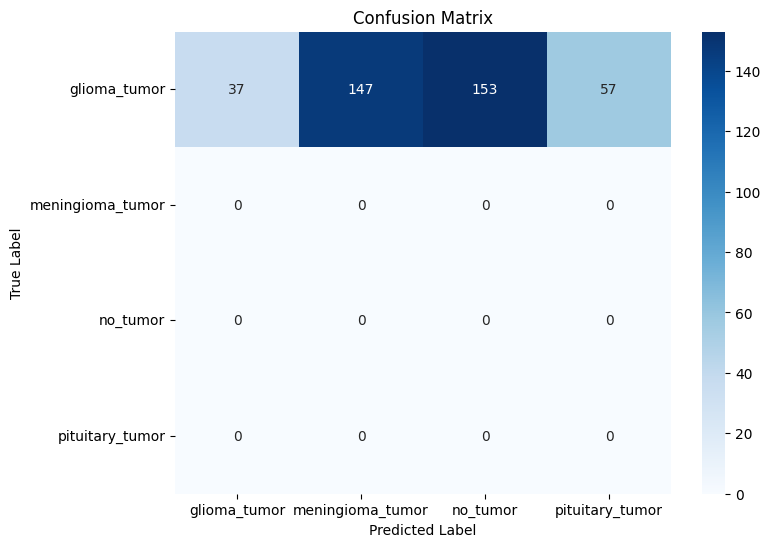

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Generate confusion matrix
cm = confusion_matrix(test_true_labels, test_pred_labels)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=unique_brain_tumour_types, yticklabels=unique_brain_tumour_types)
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.show()


In [ ]:
from sklearn.metrics import classification_report

# Generate classification report
report = classification_report(test_true_labels, test_pred_labels, target_names=unique_brain_tumour_types)
print(report)


                  precision    recall  f1-score   support

    glioma_tumor       1.00      0.09      0.17       394
meningioma_tumor       0.00      0.00      0.00         0
        no_tumor       0.00      0.00      0.00         0
 pituitary_tumor       0.00      0.00      0.00         0

        accuracy                           0.09       394
       macro avg       0.25      0.02      0.04       394
    weighted avg       1.00      0.09      0.17       394



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1171: UndefinedMetricWarning: No negative samples in y_true, false positive value should be meaningless
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1180: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1180: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1180: UndefinedMetricWarning: No positive samples in y_true, true positive value should be meaningless
  warnings.warn(


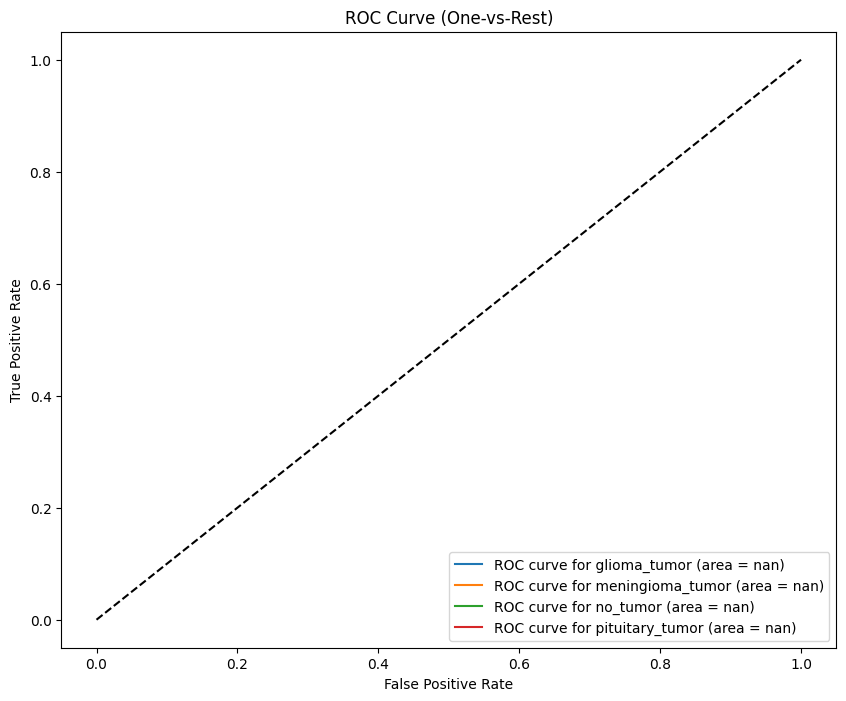

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize

# One-hot encode the true labels for multi-class ROC
test_true_labels_bin = label_binarize(test_true_labels, classes=unique_brain_tumour_types)

# Compute ROC curve and AUC for each class
fpr, tpr, roc_auc = {}, {}, {}
for i in range(len(unique_brain_tumour_types)):
    fpr[i], tpr[i], _ = roc_curve(test_true_labels_bin[:, i], test_predictions[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve
plt.figure(figsize=(10, 8))
for i in range(len(unique_brain_tumour_types)):
    plt.plot(fpr[i], tpr[i], label=f'ROC curve for {unique_brain_tumour_types[i]} (area = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve (One-vs-Rest)')
plt.legend(loc="lower right")
plt.show()


In [ ]:
from sklearn.metrics import log_loss

# Calculate Log Loss
loss = log_loss(test_true_labels_bin, test_predictions)
print(f'Log Loss: {loss:.4f}')


Log Loss: 5.2000


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_ranking.py:1027: UserWarning: No positive class found in y_true, recall is set to one for all thresholds.
  warnings.warn(


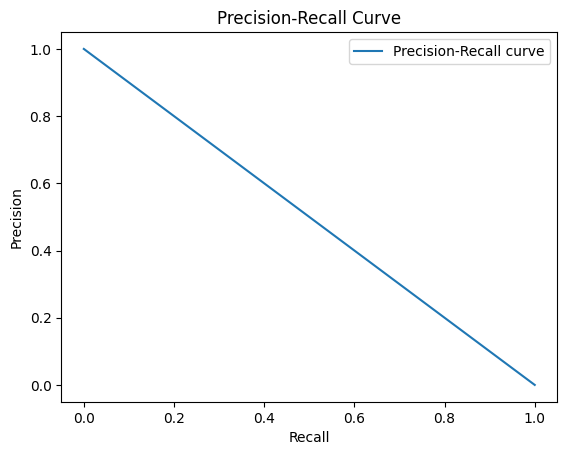

In [ ]:
from sklearn.metrics import precision_recall_curve

# Compute precision-recall curve for each class
precision, recall, _ = precision_recall_curve(test_true_labels_bin[:, 1], test_predictions[:, 1])

# Plot precision-recall curve
plt.plot(recall, precision, label='Precision-Recall curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="best")
plt.show()
